# <center> **Analysis of jokes dataset**

## Table of Contents

1. **[Functions](#1)**
2. **[General EDA](#2)**
	* [Analyzing Text Statistics](#sub-heading1)
3. **[Text Data Preprocessing](#3)**
	* [Cleaning](#sub-heading2)

# **Imports**

In [1]:
!pip install unidecode
!pip install emoji
!pip install word2number
!pip install contractions
!pip3 install spacy
!python3 -m spacy download en_core_web_sm
!python3 -m nltk.downloader stopwords
!pip install pyspellchecker
!pip install iplot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.0/12.0 MB 43.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for en_core_web_sm: filename=en_core_web_sm-2.3.1-py3-none-any.whl size=12047086 sha256=7e26fa0464b994eefddef83b8a3645d3023b253d545f150f5ace344d834bcc36
  Stored in directory: /root/.cache/pip/wheels/b7/0d/f0/7ecae8427c515065d75410989e15e5785dd3975fe06e795cd9
Successf

In [2]:
import pandas as pd
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

from scipy.stats import norm

from google.colab import drive
import os
import string
import emoji

import plotly as py
import numpy as np
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter


import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

import pylab as pl


import plotly.express as px
from plotly.subplots import make_subplots

pd.options.plotting.backend = "plotly"


import plotly.graph_objects as go


import unidecode
from word2number import w2n
import contractions
from bs4 import BeautifulSoup
import spacy

import nltk
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
nltk.download('averaged_perceptron_tagger')
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
from spellchecker import SpellChecker
from wordcloud import WordCloud

from tqdm._tqdm_notebook import tqdm_notebook
tqdm_notebook.pandas(desc='PROGRESS>>>')

from google_drive_downloader import GoogleDriveDownloader as gdd
from IPython.core.display import display, HTML

from sklearn.model_selection import RepeatedStratifiedKFold, GridSearchCV, StratifiedKFold, KFold, cross_val_score, train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import metrics
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import label_binarize, StandardScaler

from torch.optim.lr_scheduler import CosineAnnealingLR
from tqdm import tqdm
import gensim
import gensim.downloader as api
from gensim.models import Word2Vec

import gensim.downloader as gensim_api
from torch.nn.utils.rnn import pad_sequence

from functools import partial
import torch   
# from torchtext import data    
import torch.nn as nn
from torch.utils.data import TensorDataset, ConcatDataset, DataLoader, random_split, Dataset
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision
import torch.optim as optim

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [3]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)
import plotly.graph_objs as go

In [4]:
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
df = pd.read_csv('/content/drive/My Drive/NLP_humor/data/jokes_dataset.csv', 
                 sep=',', 
                 encoding='utf-8').set_index('id')

# **Functions**

In [6]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

**Activate Plotly**

In [7]:
def configure_plotly_browser_state():
    import IPython
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
            <script>
              requirejs.config({
                paths: {
                  base: '/static/base',
                  plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
                },
              });
            </script>
            '''))

**Word clouds**

In [8]:
def draw_word_clouds(data):
    fig, (ax1) = plt.subplots(1, 1, figsize=[26, 8])
    wordcloud1 = WordCloud( background_color='white',
                          width=600,
                          height=400).generate(" ".join(data['joke']))
    ax1.imshow(wordcloud1)
    ax1.axis('off')
    ax1.set_title('Joke',fontsize=40);

**Top words**

In [9]:
def draw_top_words(data, top_size, title):
    counting_table = pd.DataFrame(count_words(data, top_size))
    counting_table.drop([0],inplace=True)
    counting_table.columns = ['word','counting']

    plt.figure(figsize=(17,10))
    ax= sns.barplot(data=counting_table,x='word',y='counting',facecolor=(1, 1, 1, 0),edgecolor='black')
    if title == 'Top' or title == 'top':
      ax.set_title(f'Top {top_size} words'.title(),fontsize=20)
    else:
      ax.set_title(f'{title} words: Top {top_size}'.title(),fontsize=20)

      ax.set_ylabel('Word counting',fontsize=15)
      ax.set_xlabel(f'Top {top_size} words',fontsize=15);
      plt.xticks(rotation=45)
      plt.show()

**Removal of html tags**

In [10]:
def strip_html_tags(text):
    """remove html tags from text"""
    soup = BeautifulSoup(text, "html.parser")
    stripped_text = soup.get_text(separator=" ")
    return stripped_text

**Removal of whitespaces**

In [11]:
def remove_whitespace(text):
    """remove extra whitespaces from text"""
    text = text.strip()
    return " ".join(text.split())

**Removal of accented characters**

In [12]:
def remove_accented_chars(text):
    """remove accented characters from text, e.g. café"""
    text = unidecode.unidecode(text)
    return text

**Removal of shortened words**

In [13]:
def expand_contractions(text):
    """expand shortened words, e.g. don't to do not"""
    text = contractions.fix(text)
    return text

**Removal of urls**

In [14]:
def find_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.findall(text)

In [15]:
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

**Removal of Frequent words**

In [16]:
def count_words(text, top=10):
    cnt = Counter()
    for text in text.values:
        for word in text.split():
            cnt[word] += 1
          
    return cnt.most_common(top)

In [17]:
# FREQWORDS = set([w for (w, wc) in count_words(data['joke'], 10)])
# FREQWORDS

# n_rare_words = 10
# RAREWORDS = set([w for (w, wc) in count_words(data['joke'][:-n_rare_words-1:-1])])
# RAREWORDS

In [18]:
def remove_freqwords(text):
    """remove the frequent words"""
    return " ".join([word for word in str(text).split() if word not in FREQWORDS])

**Removal of Rare words**

In [19]:
def remove_rarewords(text):
    """remove the rare words"""
    return " ".join([word for word in str(text).split() if word not in RAREWORDS])

**Removal of stopwords**


In [20]:
STOPWORDS = set(stopwords.words('english'))

def remove_stopwords(text):
    """remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

**Convert chat words**

In [21]:
chat_words_str = """
AFAIK=As Far As I Know
AFK=Away From Keyboard
ASAP=As Soon As Possible
ATK=At The Keyboard
ATM=At The Moment
A3=Anytime, Anywhere, Anyplace
BAK=Back At Keyboard
BBL=Be Back Later
BBS=Be Back Soon
BFN=Bye For Now
B4N=Bye For Now
BRB=Be Right Back
BRT=Be Right There
BTW=By The Way
B4=Before
B4N=Bye For Now
CU=See You
CUL8R=See You Later
CYA=See You
FAQ=Frequently Asked Questions
FC=Fingers Crossed
FWIW=For What It's Worth
FYI=For Your Information
GAL=Get A Life
GG=Good Game
GN=Good Night
GMTA=Great Minds Think Alike
GR8=Great!
G9=Genius
IC=I See
ICQ=I Seek you (also a chat program)
ILU=ILU: I Love You
IMHO=In My Honest/Humble Opinion
IMO=In My Opinion
IOW=In Other Words
IRL=In Real Life
LDR=Long Distance Relationship
LMAO=Laugh My A.. Off
LOL=Laughing Out Loud
LTNS=Long Time No See
L8R=Later
MTE=My Thoughts Exactly
M8=Mate
NRN=No Reply Necessary
OIC=Oh I See
PITA=Pain In The A..
PRT=Party
PRW=Parents Are Watching
ROFL=Rolling On The Floor Laughing
ROFLOL=Rolling On The Floor Laughing Out Loud
ROTFLMAO=Rolling On The Floor Laughing My A.. Off
SK8=Skate
STATS=Your sex and age
ASL=Age, Sex, Location
THX=Thank You
TTFN=Ta-Ta For Now!
TTYL=Talk To You Later
U=You
U2=You Too
U4E=Yours For Ever
WB=Welcome Back
WTF=What The F...
WTG=Way To Go!
WUF=Where Are You From?
W8=Wait...
7K=Sick:-D Laugher
"""

In [22]:
def chat_words_conversion(text):
    new_text = []
    for w in text.split():
        if w.upper() in chat_words_list:
            new_text.append(chat_words_map_dict[w.upper()])
        else:
            new_text.append(w)
    return " ".join(new_text)

**Convertion of emoticons**

In [23]:
EMOTICONS = {
    u":‑\)":"Happy face or smiley",
    u":\)":"Happy face or smiley",
    u":-\]":"Happy face or smiley",
    u":\]":"Happy face or smiley",
    u":-3":"Happy face smiley",
    u":3":"Happy face smiley",
    u":->":"Happy face smiley",
    u":>":"Happy face smiley",
    u"8-\)":"Happy face smiley",
    u":o\)":"Happy face smiley",
    u":-\}":"Happy face smiley",
    u":\}":"Happy face smiley",
    u":-\)":"Happy face smiley",
    u":c\)":"Happy face smiley",
    u":\^\)":"Happy face smiley",
    u"=\]":"Happy face smiley",
    u"=\)":"Happy face smiley",
    u":‑D":"Laughing, big grin or laugh with glasses",
    u":D":"Laughing, big grin or laugh with glasses",
    u"8‑D":"Laughing, big grin or laugh with glasses",
    u"8D":"Laughing, big grin or laugh with glasses",
    u"X‑D":"Laughing, big grin or laugh with glasses",
    u"XD":"Laughing, big grin or laugh with glasses",
    u"=D":"Laughing, big grin or laugh with glasses",
    u"=3":"Laughing, big grin or laugh with glasses",
    u"B\^D":"Laughing, big grin or laugh with glasses",
    u":-\)\)":"Very happy",
    u":‑\(":"Frown, sad, andry or pouting",
    u":-\(":"Frown, sad, andry or pouting",
    u":\(":"Frown, sad, andry or pouting",
    u":‑c":"Frown, sad, andry or pouting",
    u":c":"Frown, sad, andry or pouting",
    u":‑<":"Frown, sad, andry or pouting",
    u":<":"Frown, sad, andry or pouting",
    u":‑\[":"Frown, sad, andry or pouting",
    u":\[":"Frown, sad, andry or pouting",
    u":-\|\|":"Frown, sad, andry or pouting",
    u">:\[":"Frown, sad, andry or pouting",
    u":\{":"Frown, sad, andry or pouting",
    u":@":"Frown, sad, andry or pouting",
    u">:\(":"Frown, sad, andry or pouting",
    u":'‑\(":"Crying",
    u":'\(":"Crying",
    u":'‑\)":"Tears of happiness",
    u":'\)":"Tears of happiness",
    u"D‑':":"Horror",
    u"D:<":"Disgust",
    u"D:":"Sadness",
    u"D8":"Great dismay",
    u"D;":"Great dismay",
    u"D=":"Great dismay",
    u"DX":"Great dismay",
    u":‑O":"Surprise",
    u":O":"Surprise",
    u":‑o":"Surprise",
    u":o":"Surprise",
    u":-0":"Shock",
    u"8‑0":"Yawn",
    u">:O":"Yawn",
    u":-\*":"Kiss",
    u":\*":"Kiss",
    u":X":"Kiss",
    u";‑\)":"Wink or smirk",
    u";\)":"Wink or smirk",
    u"\*-\)":"Wink or smirk",
    u"\*\)":"Wink or smirk",
    u";‑\]":"Wink or smirk",
    u";\]":"Wink or smirk",
    u";\^\)":"Wink or smirk",
    u":‑,":"Wink or smirk",
    u";D":"Wink or smirk",
    u":‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"X‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"XP":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"d:":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"=p":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u">:P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":-[.]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":S":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":‑\|":"Straight face",
    u":\|":"Straight face",
    u":$":"Embarrassed or blushing",
    u":‑x":"Sealed lips or wearing braces or tongue-tied",
    u":x":"Sealed lips or wearing braces or tongue-tied",
    u":‑#":"Sealed lips or wearing braces or tongue-tied",
    u":#":"Sealed lips or wearing braces or tongue-tied",
    u":‑&":"Sealed lips or wearing braces or tongue-tied",
    u":&":"Sealed lips or wearing braces or tongue-tied",
    u"O:‑\)":"Angel, saint or innocent",
    u"O:\)":"Angel, saint or innocent",
    u"0:‑3":"Angel, saint or innocent",
    u"0:3":"Angel, saint or innocent",
    u"0:‑\)":"Angel, saint or innocent",
    u"0:\)":"Angel, saint or innocent",
    u":‑b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"0;\^\)":"Angel, saint or innocent",
    u">:‑\)":"Evil or devilish",
    u">:\)":"Evil or devilish",
    u"\}:‑\)":"Evil or devilish",
    u"\}:\)":"Evil or devilish",
    u"3:‑\)":"Evil or devilish",
    u"3:\)":"Evil or devilish",
    u">;\)":"Evil or devilish",
    u"\|;‑\)":"Cool",
    u"\|‑O":"Bored",
    u":‑J":"Tongue-in-cheek",
    u"#‑\)":"Party all night",
    u"%‑\)":"Drunk or confused",
    u"%\)":"Drunk or confused",
    u":-###..":"Being sick",
    u":###..":"Being sick",
    u"<:‑\|":"Dump",
    u"\(>_<\)":"Troubled",
    u"\(>_<\)>":"Troubled",
    u"\(';'\)":"Baby",
    u"\(\^\^>``":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(\^_\^;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(~_~;\) \(・\.・;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-\)zzz":"Sleeping",
    u"\(\^_-\)":"Wink",
    u"\(\(\+_\+\)\)":"Confused",
    u"\(\+o\+\)":"Confused",
    u"\(o\|o\)":"Ultraman",
    u"\^_\^":"Joyful",
    u"\(\^_\^\)/":"Joyful",
    u"\(\^O\^\)／":"Joyful",
    u"\(\^o\^\)／":"Joyful",
    u"\(__\)":"Kowtow as a sign of respect, or dogeza for apology",
    u"_\(\._\.\)_":"Kowtow as a sign of respect, or dogeza for apology",
    u"<\(_ _\)>":"Kowtow as a sign of respect, or dogeza for apology",
    u"<m\(__\)m>":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(__\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(_ _\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"\('_'\)":"Sad or Crying",
    u"\(/_;\)":"Sad or Crying",
    u"\(T_T\) \(;_;\)":"Sad or Crying",
    u"\(;_;":"Sad of Crying",
    u"\(;_:\)":"Sad or Crying",
    u"\(;O;\)":"Sad or Crying",
    u"\(:_;\)":"Sad or Crying",
    u"\(ToT\)":"Sad or Crying",
    u";_;":"Sad or Crying",
    u";-;":"Sad or Crying",
    u";n;":"Sad or Crying",
    u";;":"Sad or Crying",
    u"Q\.Q":"Sad or Crying",
    u"T\.T":"Sad or Crying",
    u"QQ":"Sad or Crying",
    u"Q_Q":"Sad or Crying",
    u"\(-\.-\)":"Shame",
    u"\(-_-\)":"Shame",
    u"\(一一\)":"Shame",
    u"\(；一_一\)":"Shame",
    u"\(=_=\)":"Tired",
    u"\(=\^\·\^=\)":"cat",
    u"\(=\^\·\·\^=\)":"cat",
    u"=_\^=	":"cat",
    u"\(\.\.\)":"Looking down",
    u"\(\._\.\)":"Looking down",
    u"\^m\^":"Giggling with hand covering mouth",
    u"\(\・\・?":"Confusion",
    u"\(?_?\)":"Confusion",
    u">\^_\^<":"Normal Laugh",
    u"<\^!\^>":"Normal Laugh",
    u"\^/\^":"Normal Laugh",
    u"\（\*\^_\^\*）" :"Normal Laugh",
    u"\(\^<\^\) \(\^\.\^\)":"Normal Laugh",
    u"\(^\^\)":"Normal Laugh",
    u"\(\^\.\^\)":"Normal Laugh",
    u"\(\^_\^\.\)":"Normal Laugh",
    u"\(\^_\^\)":"Normal Laugh",
    u"\(\^\^\)":"Normal Laugh",
    u"\(\^J\^\)":"Normal Laugh",
    u"\(\*\^\.\^\*\)":"Normal Laugh",
    u"\(\^—\^\）":"Normal Laugh",
    u"\(#\^\.\^#\)":"Normal Laugh",
    u"\（\^—\^\）":"Waving",
    u"\(;_;\)/~~~":"Waving",
    u"\(\^\.\^\)/~~~":"Waving",
    u"\(-_-\)/~~~ \($\·\·\)/~~~":"Waving",
    u"\(T_T\)/~~~":"Waving",
    u"\(ToT\)/~~~":"Waving",
    u"\(\*\^0\^\*\)":"Excited",
    u"\(\*_\*\)":"Amazed",
    u"\(\*_\*;":"Amazed",
    u"\(\+_\+\) \(@_@\)":"Amazed",
    u"\(\*\^\^\)v":"Laughing,Cheerful",
    u"\(\^_\^\)v":"Laughing,Cheerful",
    u"\(\(d[-_-]b\)\)":"Headphones,Listening to music",
    u'\(-"-\)':"Worried",
    u"\(ーー;\)":"Worried",
    u"\(\^0_0\^\)":"Eyeglasses",
    u"\(\＾ｖ\＾\)":"Happy",
    u"\(\＾ｕ\＾\)":"Happy",
    u"\(\^\)o\(\^\)":"Happy",
    u"\(\^O\^\)":"Happy",
    u"\(\^o\^\)":"Happy",
    u"\)\^o\^\(":"Happy",
    u":O o_O":"Surprised",
    u"o_0":"Surprised",
    u"o\.O":"Surpised",
    u"\(o\.o\)":"Surprised",
    u"oO":"Surprised",
    u"\(\*￣m￣\)":"Dissatisfied",
    u"\(‘A`\)":"Snubbed or Deflated"
}

In [24]:
def convert_emoticons(text):
    for emot in EMOTICONS:
        text = re.sub(u'('+emot+')', "_".join(EMOTICONS[emot].replace(",","").split()), text)
    return text

**Removal of Punctuations**

In [25]:
PUNCT_TO_REMOVE = string.punctuation

def remove_punctuation(text):
    """custom function to remove the punctuation"""
    return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))

**Removal of numbers**

In [26]:
def remove_numbers(input):
    input_str = re.sub(r'\d+', "", input)
    return input_str

**Find emoji**

In [27]:
def extract_emojis(s):
    return ''.join(c for c in s if c in emoji.UNICODE_EMOJI['en'])

**Stemming**

In [28]:
stemmer = PorterStemmer()

def stem_words(text):
    return " ".join([stemmer.stem(word) for word in text])

**Word importance**

In [29]:
# def get_word_importance(model,tfidf, top=15):

#     important_tokens = pd.DataFrame(
#         data=model.coef_[0],
#         index=tfidf.get_feature_names(),
#         columns=['Coefs']
#     )

#     important_tokens_pos = important_tokens.sort_values(by='Coefs', ascending=False)[:top]
#     important_tokens_neg = important_tokens.sort_values(by='Coefs', ascending=False)[-top:]

#     word_imp = important_tokens_pos.copy(deep=True)
#     word_imp = word_imp.append(important_tokens_neg)

#     plt.figure(figsize=(15,10))
#     sns.barplot(x=word_imp.index, y='Coefs', data=word_imp)
#     plt.title('Word importance')
#     plt.xlabel('POS             vs.               NEG')
#     plt.ylabel('word weight')
#     plt.xticks(rotation=55)
#     plt.show()

# **EDA**

### **Features description**  

* **id** -- submission ID in the subreddit.
* **score** -- post score displayed on Reddit.
* **title** -- title of the submission.

**PS:** Note that the title is in part of the joke. (except Nan in title, there I just take body)

In [30]:
df.head()

,body,score,title
id,,,
5tz52q,"Now I have to say ""Leroy can you please paint ...",1.0,I hate how you cant even say black paint anymore
5tz4dd,Pizza doesn't scream when you put it in the ov...,0.0,What's the difference between a Jew in Nazi Ge...
5tz319,...and being there really helped me learn abou...,0.0,I recently went to America....
5tz2wj,A Sunday school teacher is concerned that his ...,1.0,"Brian raises his hand and says, “He’s in Heaven.”"
5tz1pc,He got caught trying to sell the two books to ...,0.0,You hear about the University book store worke...


## **Check missing data**

In [38]:
df.isnull().sum()

body     0
score    0
title    0
dtype: int64

In [39]:
df[df['body'].isna() == True]

,body,score,title
id,,,


In [40]:
df = df.dropna(subset=['title', 'score'])

* You may notice that some jokes are entirely placed in the "body" column, so I will replace NaN in the "title" with an empty line.

So, now we have full jokes in body, not in title.

In [41]:
df.isna().sum()

body     0
score    0
title    0
dtype: int64

In [42]:
df['body'] = df['body'].fillna('')

In [43]:
df.isna().sum()

body     0
score    0
title    0
dtype: int64

In [44]:
df['score'] = df['score'].astype(np.int32)

## **Make new df with full joke text**

* You can try to combine the two columns "title" and "body" into one joke.

In [45]:
data = df.copy(deep=True)

In [46]:
data["joke"] = data["title"] + ". " + data["body"]

In [47]:
data.drop(['title', 'body'], axis=1, inplace=True)

In [48]:
data.head()

,score,joke
id,,
5tz52q,1,I hate how you cant even say black paint anymo...
5tz4dd,0,What's the difference between a Jew in Nazi Ge...
5tz319,0,I recently went to America..... ...and being t...
5tz2wj,1,"Brian raises his hand and says, “He’s in Heave..."
5tz1pc,0,You hear about the University book store worke...


In [49]:
data.shape

(194553, 2)

## **Dropping duplicates**

* Lets look for duplicates in data.

In [50]:
data.shape

(194553, 2)

In [51]:
data.drop_duplicates(inplace=True)
data.shape

(193907, 2)

* 646 duplicates were found and deleted.

## **Analyzing Text Statistics** 


**Let's look at an example of samples:**  

In [52]:
data['joke'][0]

'I hate how you cant even say black paint anymore. Now I have to say "Leroy can you please paint the fence?"'

**Distribution of scores**

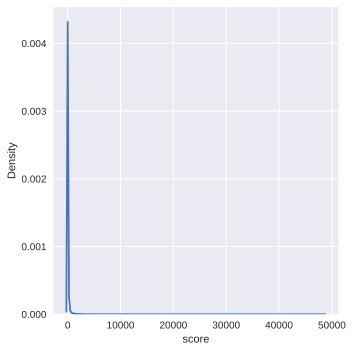

In [54]:
sns.displot(data['score'], kind="kde")
plt.show()

In [46]:
data['score'].value_counts()

0        61082
1        19272
2        13650
3         9612
4         7413
         ...  
17973        1
1895         1
7904         1
2947         1
1435         1
Name: score, Length: 3639, dtype: int64

* So, it can be seen that target has long tail.

In [47]:
data['score'].min()

0

In [48]:
data['score'].max()

48526

* Most scores are located near zero. The distribution is strongly shifted to the left.

In [49]:
new_df = data.copy(deep=True)

Looking at text length distribution:

In [50]:
new_df['text_len'] = new_df['joke'].astype(str).apply(len)
new_df['text_word_count'] = new_df['joke'].apply(lambda x: len(str(x).split()))
new_df.head(1)

,score,joke,text_len,text_word_count
id,,,,
5tz52q,1,I hate how you cant even say black paint anymo...,107,22


In [51]:
configure_plotly_browser_state()

init_notebook_mode(connected=False)

new_df['text_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='text length',
    linecolor='black',
    color='red',
    yTitle='count',
    title='Text Length Distribution')

* Most jokes are short.

In [52]:
configure_plotly_browser_state()

init_notebook_mode(connected=False)

trace0 = go.Box(
    y=new_df['text_len'],
    name = 'Text',
    marker = dict(
        color = 'red',
    )
)

d = [trace0]
layout = go.Layout(
    title = "Length of the text"
)

fig = go.Figure(data=d,layout=layout)
iplot(fig, filename = "Length of the text")

* The histogram shows that the length of not cleaned text ranges from around 1 to 40k+ characters.

## **Same jokes have different scores:**   
Now I take the biggest score from a joke and set this value to all duplicates, then I delete duplicates.

In [53]:
print('The number of duplicated data is:',sum(data['joke'].duplicated()))

The number of duplicated data is: 2498


In [54]:
dupls = data[data['joke'].duplicated() == True]['joke'].unique()
dupls

array(['What did the leper say to the prostitute?. Keep the tip.',
       "What is Mexico's National Animal?. The drug mule.",
       'A blind man walks into a bar.... and a table... and a chair.',
       ..., "What's big and brown and rhymes with snoop?. Dr. Dre",
       'How do you know if your roommate is gay?. His dick tastes like shit.',
       'Why do they call it PMS?. Because mad cow disease was already taken '],
      dtype=object)

In [55]:
dupls = data[data['joke'].duplicated() == True]['joke'].unique()

for j in dupls:
  max_score = max(set(data[data['joke'] == j]['score']))
  joke_idxs = data[data['joke'] == j].index
  data['score'][joke_idxs] = max_score
  

In [56]:
data[data['joke'] == dupls[0]]

,score,joke
id,,
5t6548,252,What did the leper say to the prostitute?. Kee...
5swmk6,252,What did the leper say to the prostitute?. Kee...
525zmr,252,What did the leper say to the prostitute?. Kee...
4zzal9,252,What did the leper say to the prostitute?. Kee...
4yf0xg,252,What did the leper say to the prostitute?. Kee...
4t2ajn,252,What did the leper say to the prostitute?. Kee...
48hd0j,252,What did the leper say to the prostitute?. Kee...
46fpv4,252,What did the leper say to the prostitute?. Kee...
43luzn,252,What did the leper say to the prostitute?. Kee...


Removal of duplicates

In [57]:
data.shape

(193907, 2)

In [58]:
data.drop_duplicates(inplace=True)
data.shape

(191409, 2)

## **Split 'score' in 4 quantiles (make 5 classes):**

In [59]:
data.groupby(pd.cut(data.score, np.percentile(data.score, [20, 40, 60, 80]), include_lowest=True)).mean()

,score
score,
"(-0.001, 1.0]",0.239365
"(1.0, 5.0]",3.151650
"(5.0, 26.0]",12.504386


In [60]:
def add_rank(data):
  if data == 0:
    return 0
  elif (data > 0) and( data <= 1):
    return 1 
  elif (data > 1)and (data <= 6):
    return 2
  elif (data > 6)and (data <= 28):
    return 3
  elif data > 28:
    return 4

In [61]:
data['rank'] = data['score'].apply(add_rank)

**Drop joke from one word:**

In [62]:
data['text_word_count'] = data['joke'].apply(lambda x: len(str(x).split()))
data.head(1)

,score,joke,rank,text_word_count
id,,,,
5tz52q,1,I hate how you cant even say black paint anymo...,1,22


In [63]:
data[data['text_word_count'] == 1]

,score,joke,rank,text_word_count
id,,,,
4nfz1o,0,Gandalf.,0,1
3xunbs,0,4-chan.,0,1
3xo5ma,0,You..,0,1
3xidod,0,Religion.,0,1
3wxoj1,0,Bing.,0,1
...,...,...,...,...
1p5dzb,0,Feminisim.,0,1
1nju7e,941,Congress.,4,1
1j5l9y,0,71..,0,1


In [64]:
data = data[data['text_word_count'] != 1]
data.drop(['score',	'text_word_count'], axis=1, inplace=True)

In [65]:
data.head()

,joke,rank
id,,
5tz52q,I hate how you cant even say black paint anymo...,1
5tz4dd,What's the difference between a Jew in Nazi Ge...,0
5tz319,I recently went to America..... ...and being t...,0
5tz2wj,"Brian raises his hand and says, “He’s in Heave...",1
5tz1pc,You hear about the University book store worke...,0


In [66]:
data['rank'].value_counts()

0    60444
2    40951
4    36853
3    34033
1    19038
Name: rank, dtype: int64

## **Meta Features**  

Distributions of meta features in classes and datasets can be helpful. 

* *word_count* number of words in text
* *unique_word_count* number of unique words in text
* *stop_word_count* number of stop words in text
* url_count number of urls in text
* *mean_word_length* average character count in words
* *char_count* number of characters in text
* *punctuation_count* number of punctuations in text
* *hashtag_count* number of hashtags (#) in text
* *mention_count* number of mentions (@) in text

In [67]:
new_df = data.copy()

In [68]:
# word_count
new_df['word_count'] = new_df['joke'].apply(lambda x: len(str(x).split()))

# unique_word_count
new_df['unique_word_count'] = new_df['joke'].apply(lambda x: len(set(str(x).split())))

# stop_word_count
new_df['stop_word_count'] = new_df['joke'].apply(lambda x: len([w for w in str(x).lower().split() if w in STOPWORDS]))

# url_count
new_df['url_count'] = new_df['joke'].apply(lambda x: len([w for w in str(x).lower().split() if 'http' in w or 'https' in w]))

# mean_word_length
new_df['mean_word_length'] = new_df['joke'].apply(lambda x: np.mean([len(w) for w in str(x).split()]))

# char_count
new_df['char_count'] = new_df['joke'].apply(lambda x: len(str(x)))

# punctuation_count
new_df['punctuation_count'] = new_df['joke'].apply(lambda x: len([c for c in str(x) if c in string.punctuation]))

# hashtag_count
new_df['hashtag_count'] = new_df['joke'].apply(lambda x: len([c for c in str(x) if c == '#']))

# mention_count
new_df['mention_count'] = new_df['joke'].apply(lambda x: len([c for c in str(x) if c == '@']))


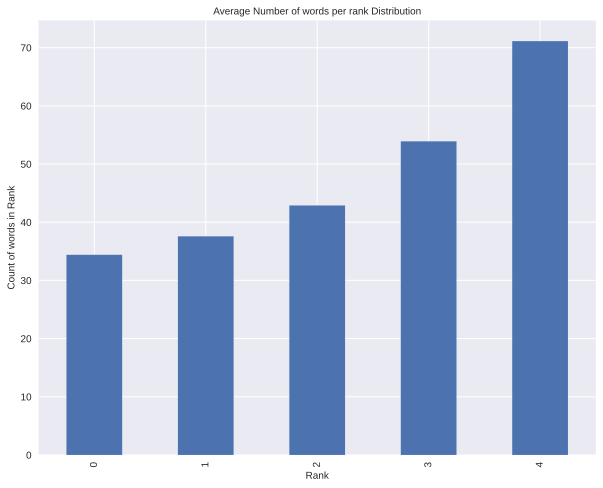

In [ ]:
letter_avg = new_df.groupby('rank')['word_count'].mean().plot(kind='bar', figsize=(10,8))
plt.xlabel('Rank', fontsize=10)
plt.ylabel('Count of words in Rank', fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title(f'Average Number of words per rank Distribution', fontsize=10)
plt.show()

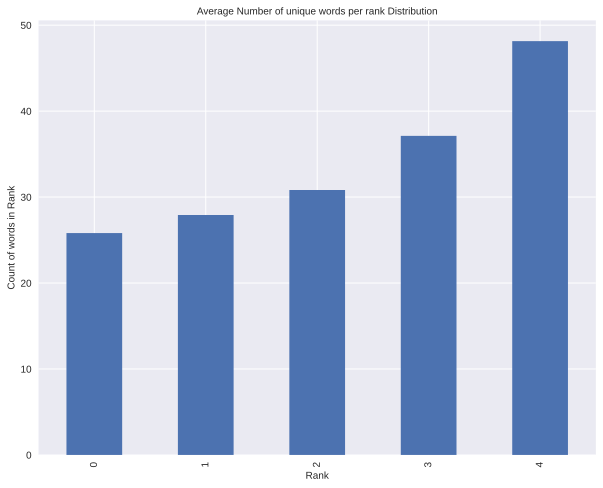

In [ ]:
letter_avg = new_df.groupby('rank')['unique_word_count'].mean().plot(kind='bar', figsize=(10,8))
plt.xlabel('Rank', fontsize=10)
plt.ylabel('Count of words in Rank', fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title(f'Average Number of unique words per rank Distribution', fontsize=10)
plt.show()

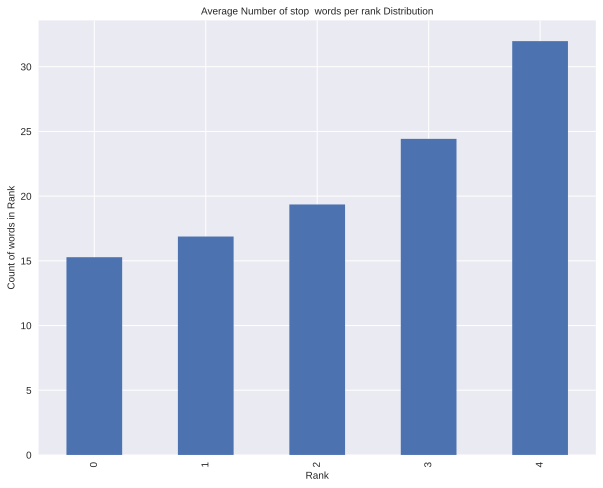

In [ ]:
letter_avg = new_df.groupby('rank')['stop_word_count'].mean().plot(kind='bar', figsize=(10,8))
plt.xlabel('Rank', fontsize=10)
plt.ylabel('Count of words in Rank', fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title(f'Average Number of stop  words per rank Distribution', fontsize=10)
plt.show()

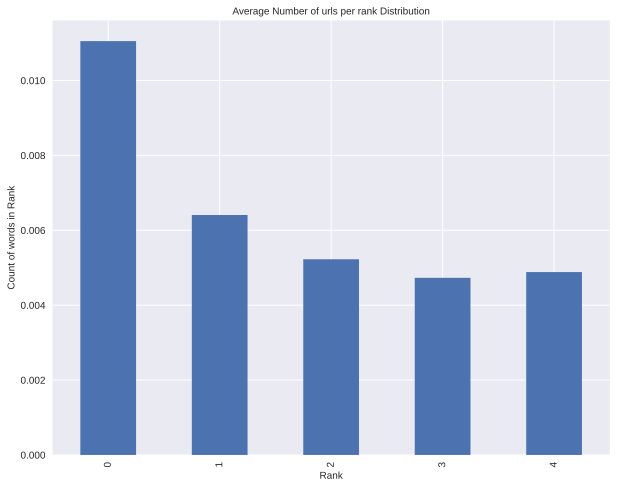

In [ ]:
letter_avg = new_df.groupby('rank')['url_count'].mean().plot(kind='bar', figsize=(10,8))
plt.xlabel('Rank', fontsize=10)
plt.ylabel('Count of words in Rank', fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title(f'Average Number of urls per rank Distribution', fontsize=10)
plt.show()

* It seems that the funniest jokes have a longer length than non-funny jokes. Also, funnier jokes have more unique words and obscene expressions. However, the most unfunny jokes contain more hashtags.

### **Looking at our new target distribution**

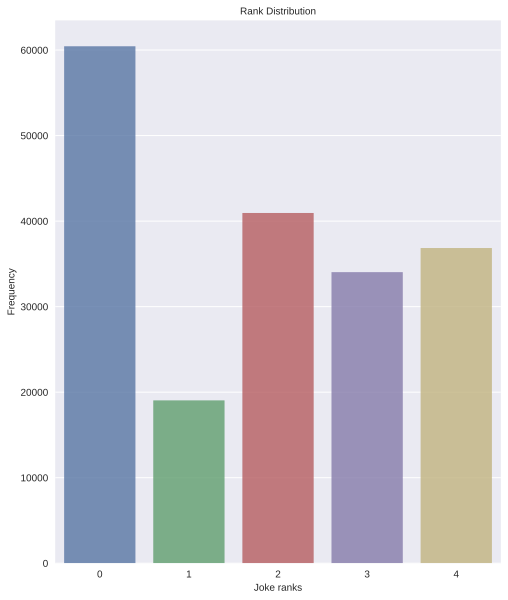

In [ ]:
x_rating = new_df['rank'].value_counts()
y_rating = x_rating.sort_index()
plt.figure(figsize=(8,10))
sns.barplot(x_rating.index, x_rating.values, alpha=0.8)
plt.title("Rank Distribution", fontsize=10)
plt.ylabel('Frequency', fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('Joke ranks', fontsize=10)
plt.xticks(fontsize=10)
plt.show()

In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

values_cat1 = [len(new_df[new_df['rank'] == item]) for item in new_df['rank'].unique()]
labels = ['NOT_JOKE', 'BAD_JOKE', 'SO_SO_JOKE',
       'FUNNY_JOKE', 'BEST_JOKE']


# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=1,  specs=[[{'type':'domain'}]])
fig.add_trace(go.Pie(labels=labels, values=values_cat1, name="request for change"),
              1, 1)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.5, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="Target",
    autosize=False,
    width=800,
    height=800)
iplot(fig)


## **Term Frequency Analysis**  

Let’s take an in-depth look at the actual reviews themselves. What are the most common words? What are the most common words by rating? Answers to these questions will provide further insights into the jokes ratings.


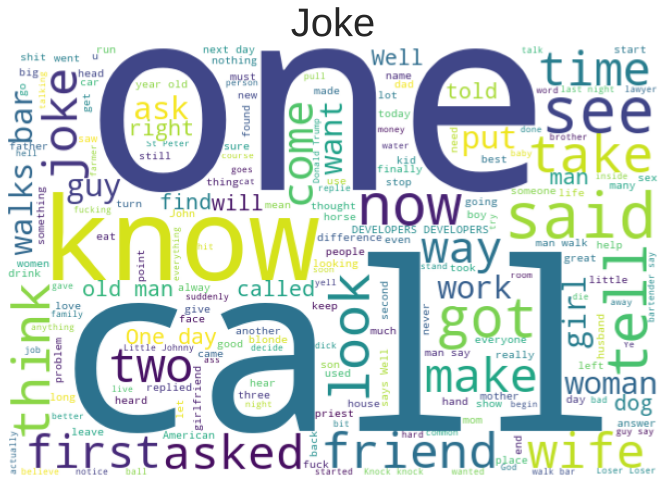

In [ ]:
draw_word_clouds(new_df)

* It is obvious that the text has not been processed and there are many words with high frequency.
* 'one', 'say', 'said' are the most frequent ones. 
* However, on the other hand, you can notice that many jokes contain the words "wife", "friend", "bar" and so on.

### **N-grams**

In [69]:
NOT_JOKE = new_df['rank'] == 0
BAD_JOKE = new_df['rank'] == 1
SO_SO_JOKE = new_df['rank'] == 2
FUNNY_JOKE = new_df['rank'] == 3
BEST_JOKE = new_df['rank'] == 4

In [ ]:
new_df['joke'] = new_df['joke'].apply(lambda text: remove_numbers(text))
new_df.head(1)

,joke,rank
id,,
5tz52q,I hate how you cant even say black paint anymo...,1


In [ ]:
def generate_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(' ') if token != '' if token not in STOPWORDS]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

N = 30

# Unigrams
not_unigrams = defaultdict(int)
bad_unigrams = defaultdict(int)
so_so_unigrams = defaultdict(int)
funny_unigrams = defaultdict(int)
best_unigrams = defaultdict(int)

for joke in new_df[NOT_JOKE]['joke']:
    for word in generate_ngrams(joke):
        not_unigrams[word] += 1
        
for joke in new_df[BAD_JOKE]['joke']:
    for word in generate_ngrams(joke):
        bad_unigrams[word] += 1

for joke in new_df[SO_SO_JOKE]['joke']:
    for word in generate_ngrams(joke):
        so_so_unigrams[word] += 1

for joke in new_df[FUNNY_JOKE]['joke']:
    for word in generate_ngrams(joke):
        funny_unigrams[word] += 1

for joke in new_df[BEST_JOKE]['joke']:
    for word in generate_ngrams(joke):
        best_unigrams[word] += 1
        
df_not_unigrams = pd.DataFrame(sorted(not_unigrams.items(), key=lambda x: x[1])[::-1])
df_bad_unigrams = pd.DataFrame(sorted(bad_unigrams.items(), key=lambda x: x[1])[::-1])
df_so_so_unigrams = pd.DataFrame(sorted(so_so_unigrams.items(), key=lambda x: x[1])[::-1])
df_funny_unigrams = pd.DataFrame(sorted(funny_unigrams.items(), key=lambda x: x[1])[::-1])
df_best_unigrams = pd.DataFrame(sorted(best_unigrams.items(), key=lambda x: x[1])[::-1])

# Bigrams
not_bigrams = defaultdict(int)
bad_bigrams = defaultdict(int)
so_so_bigrams = defaultdict(int)
funny_bigrams = defaultdict(int)
best_bigrams = defaultdict(int)

for joke in new_df[NOT_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=2):
        not_bigrams[word] += 1
        
for joke in new_df[BAD_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=2):
        bad_bigrams[word] += 1

for joke in new_df[SO_SO_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=2):
        so_so_bigrams[word] += 1

for joke in new_df[FUNNY_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=2):
        funny_bigrams[word] += 1

for joke in new_df[BEST_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=2):
        best_bigrams[word] += 1
        
df_not_bigrams = pd.DataFrame(sorted(not_bigrams.items(), key=lambda x: x[1])[::-1])
df_bad_bigrams = pd.DataFrame(sorted(bad_bigrams.items(), key=lambda x: x[1])[::-1])
df_so_so_bigrams = pd.DataFrame(sorted(so_so_bigrams.items(), key=lambda x: x[1])[::-1])
df_funny_bigrams = pd.DataFrame(sorted(funny_bigrams.items(), key=lambda x: x[1])[::-1])
df_best_bigrams = pd.DataFrame(sorted(best_bigrams.items(), key=lambda x: x[1])[::-1])

# Trigrams
not_trigrams = defaultdict(int)
bad_trigrams = defaultdict(int)
so_so_trigrams = defaultdict(int)
funny_trigrams = defaultdict(int)
best_trigrams = defaultdict(int)

for joke in new_df[NOT_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=3):
        not_trigrams[word] += 1
        
for joke in new_df[BAD_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=3):
        bad_trigrams[word] += 1

for joke in new_df[SO_SO_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=3):
        so_so_trigrams[word] += 1

for joke in new_df[FUNNY_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=3):
        funny_trigrams[word] += 1

for joke in new_df[BEST_JOKE]['joke']:
    for word in generate_ngrams(joke, n_gram=3):
        best_trigrams[word] += 1
        
df_not_trigrams = pd.DataFrame(sorted(not_trigrams.items(), key=lambda x: x[1])[::-1])
df_bad_trigrams = pd.DataFrame(sorted(bad_trigrams.items(), key=lambda x: x[1])[::-1])
df_so_so_trigrams = pd.DataFrame(sorted(so_so_trigrams.items(), key=lambda x: x[1])[::-1])
df_funny_trigrams = pd.DataFrame(sorted(funny_trigrams.items(), key=lambda x: x[1])[::-1])
df_best_trigrams = pd.DataFrame(sorted(best_trigrams.items(), key=lambda x: x[1])[::-1])

### **Unigrams**

The most common unigrams that exist in classes are mainly "man", "one" and "say", since this is how jokes most often begin. I don't think it's worth clearing these words, since they carry part of the meaning of the joke.

The most common unigrams in disaster tweets already contain information about disasters. It is very difficult to use some of these words in other contexts.

The most common unigrams in the funniest jokes are words concerning women.

In [ ]:
from collections import defaultdict

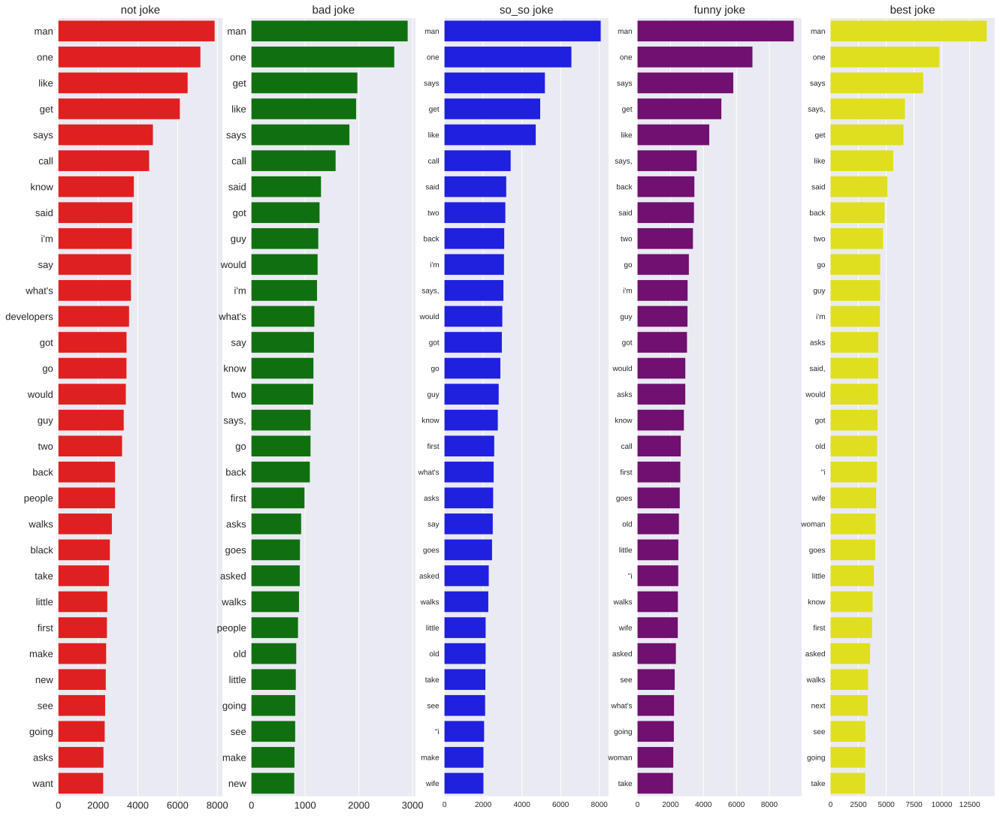

In [ ]:
fig, axes = plt.subplots(ncols=5, figsize=(18, 15), dpi=100)
plt.tight_layout()

sns.barplot(y=df_not_unigrams[0].values[:N], x=df_not_unigrams[1].values[:N], ax=axes[0], color='red')
sns.barplot(y=df_bad_unigrams[0].values[:N], x=df_bad_unigrams[1].values[:N], ax=axes[1], color='green')
sns.barplot(y=df_so_so_unigrams[0].values[:N], x=df_so_so_unigrams[1].values[:N], ax=axes[2], color='blue')
sns.barplot(y=df_funny_unigrams[0].values[:N], x=df_funny_unigrams[1].values[:N], ax=axes[3], color='purple')
sns.barplot(y=df_best_unigrams[0].values[:N], x=df_best_unigrams[1].values[:N], ax=axes[4], color='yellow')


for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=13)

axes[0].set_title('not joke', fontsize=15)
axes[1].set_title(f'bad joke', fontsize=15)
axes[2].set_title(f'so_so joke', fontsize=15)
axes[3].set_title(f'funny joke', fontsize=15)
axes[4].set_title(f'best joke', fontsize=15)

plt.show()

### **Bigrams**

There are still a lot of common bigrams in both classes, but the context is becoming clearer. But there are also a lot of punctuation marks.

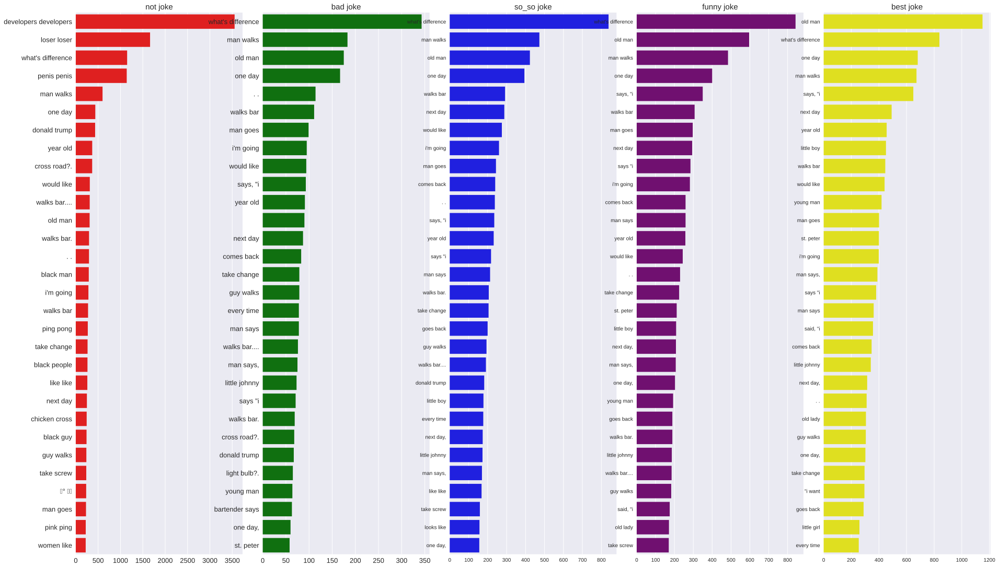

In [ ]:
fig, axes = plt.subplots(ncols=5, figsize=(25, 15), dpi=100)
plt.tight_layout()

sns.barplot(y=df_not_bigrams[0].values[:N], x=df_not_bigrams[1].values[:N], ax=axes[0], color='red')
sns.barplot(y=df_bad_bigrams[0].values[:N], x=df_bad_bigrams[1].values[:N], ax=axes[1], color='green')
sns.barplot(y=df_so_so_bigrams[0].values[:N], x=df_so_so_bigrams[1].values[:N], ax=axes[2], color='blue')
sns.barplot(y=df_funny_bigrams[0].values[:N], x=df_funny_bigrams[1].values[:N], ax=axes[3], color='purple')
sns.barplot(y=df_best_bigrams[0].values[:N], x=df_best_bigrams[1].values[:N], ax=axes[4], color='yellow')


for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=13)

axes[0].set_title('not joke', fontsize=15)
axes[1].set_title(f'bad joke', fontsize=15)
axes[2].set_title(f'so_so joke', fontsize=15)
axes[3].set_title(f'funny joke', fontsize=15)
axes[4].set_title(f'best joke', fontsize=15)
plt.show()

### **Trigrams**
All trigrams are very similar to each other, so it will be more difficult to divide jokes into classes. And there are a lot of punctuation marks, so it's worth removing them from the text.

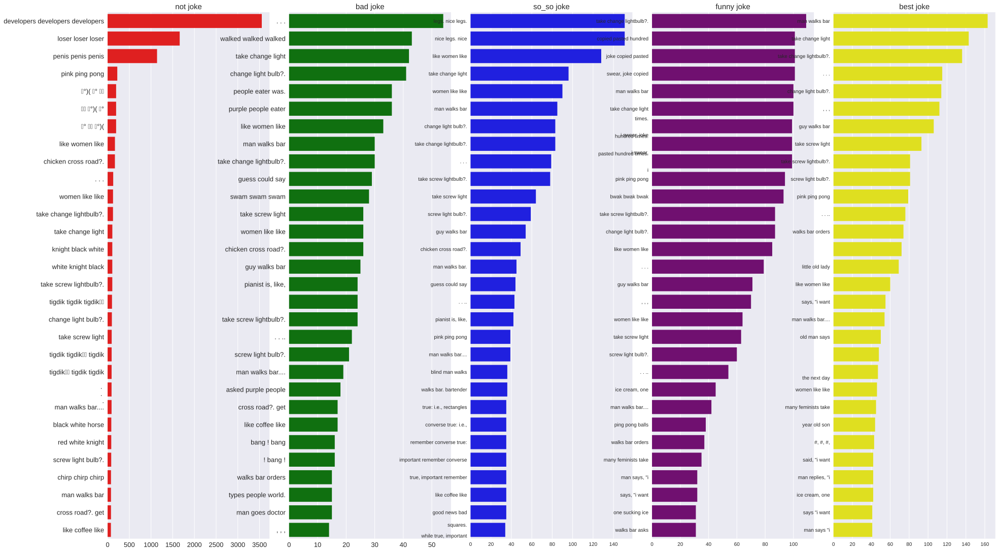

In [ ]:
fig, axes = plt.subplots(ncols=5, figsize=(25, 15), dpi=100)
plt.tight_layout()

sns.barplot(y=df_not_trigrams[0].values[:N], x=df_not_trigrams[1].values[:N], ax=axes[0], color='red')
sns.barplot(y=df_bad_trigrams[0].values[:N], x=df_bad_trigrams[1].values[:N], ax=axes[1], color='green')
sns.barplot(y=df_so_so_trigrams[0].values[:N], x=df_so_so_trigrams[1].values[:N], ax=axes[2], color='blue')
sns.barplot(y=df_funny_trigrams[0].values[:N], x=df_funny_trigrams[1].values[:N], ax=axes[3], color='purple')
sns.barplot(y=df_best_trigrams[0].values[:N], x=df_best_trigrams[1].values[:N], ax=axes[4], color='yellow')


for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=13)

axes[0].set_title('not joke', fontsize=15)
axes[1].set_title(f'bad joke', fontsize=15)
axes[2].set_title(f'so_so joke', fontsize=15)
axes[3].set_title(f'funny joke', fontsize=15)
axes[4].set_title(f'best joke', fontsize=15)
plt.show()

## **Embeddings Coverage**  

When you have pre-trained embeddings, doing standard preprocessing steps might not be a good idea because some of the valuable information can be lost. It is better to get vocabulary as close to embeddings as possible. In order to do that, vocab шы created by counting the words in jokes.  

Text cleaning is based on the embeddings below:  

GloVe-300d-840B  
FastText-Crawl-300d-2M  

In [ ]:
%%time
glove_embeddings = np.load('/content/drive/My Drive/NLP_humor/data/gl/glove.840B.300d.pkl', allow_pickle=True)
fasttext_embeddings = np.load('/content/drive/My Drive/NLP_humor/data/ft/crawl-300d-2M.pkl', allow_pickle=True)

CPU times: user 13.7 s, sys: 7.06 s, total: 20.8 s
Wall time: 32.1 s


Words in the intersection of vocab and embeddings are stored in covered along with their counts. Words in vocab that don't exist in embeddings are stored in oov along with their counts. n_covered and n_oov are total number of counts and they are used for calculating coverage percentages.

Both GloVe and FastText embeddings cover a very low % of vocabulary and text without cleaning. GloVe and FastText coverage are very close but FastText has slightly higher coverage. So, text should be cleaned and models have to be finetuned.

In [ ]:
import operator 

def build_vocab(X):
    
    tweets = X.apply(lambda s: s.split()).values      
    vocab = {}
    
    for tweet in tweets:
        for word in tweet:
            try:
                vocab[word] += 1
            except KeyError:
                vocab[word] = 1                
    return vocab


def check_embeddings_coverage(X, embeddings):
    
    vocab = build_vocab(X)    
    
    covered = {}
    oov = {}    
    n_covered = 0
    n_oov = 0
    
    for word in vocab:
        try:
            covered[word] = embeddings[word]
            n_covered += vocab[word]
        except:
            oov[word] = vocab[word]
            n_oov += vocab[word]
            
    vocab_coverage = len(covered) / len(vocab)
    text_coverage = (n_covered / (n_covered + n_oov))
    
    sorted_oov = sorted(oov.items(), key=operator.itemgetter(1))[::-1]
    return sorted_oov, vocab_coverage, text_coverage

glove_oov, glove_vocab_coverage, glove_text_coverage = check_embeddings_coverage(new_df['joke'], glove_embeddings)
print('GloVe Embeddings cover {:.2%} of vocabulary and {:.2%} of text in  dataset'.format(glove_vocab_coverage, glove_text_coverage))

fasttext_oov, fasttext_vocab_coverage, fasttext_text_coverage = check_embeddings_coverage(new_df['joke'], fasttext_embeddings)
print('FastText Embeddings cover {:.2%} of vocabulary and {:.2%} of text in dataset'.format(fasttext_vocab_coverage, fasttext_text_coverage))

GloVe Embeddings cover 24.06% of vocabulary and 84.81% of text in  dataset
FastText Embeddings cover 27.35% of vocabulary and 86.62% of text in dataset


# **Topic Modeling**

Finally, let’s apply a few topic modeling algorithms to help derive specific topics or themes for our jokes. Before we have determined the topics for each rating we have to perform one additional processing step. We need to convert our text into numbers or vectors.

In [70]:
from sklearn.decomposition import TruncatedSVD

In [71]:
reindexed_data = new_df['joke']
tfidf_vectorizer = TfidfVectorizer(stop_words='english', use_idf=True, smooth_idf=True)
reindexed_data = reindexed_data.values
document_term_matrix = tfidf_vectorizer.fit_transform(reindexed_data)

In [72]:
n_topics = 6
lsa_model = TruncatedSVD(n_components=n_topics)
lsa_topic_matrix = lsa_model.fit_transform(document_term_matrix)

In [73]:
def get_keys(topic_matrix):
    '''
    returns an integer list of predicted topic 
    categories for a given topic matrix
    '''
    keys = topic_matrix.argmax(axis=1).tolist()
    return keys

def keys_to_counts(keys):
    '''
    returns a tuple of topic categories and their 
    accompanying magnitudes for a given list of keys
    '''
    count_pairs = Counter(keys).items()
    categories = [pair[0] for pair in count_pairs]
    counts = [pair[1] for pair in count_pairs]
    return (categories, counts)

In [74]:
lsa_keys = get_keys(lsa_topic_matrix)
lsa_categories, lsa_counts = keys_to_counts(lsa_keys)

In [75]:
def get_top_n_words(n, keys, document_term_matrix, tfidf_vectorizer):
    '''
    returns a list of n_topic strings, where each string contains the n most common 
    words in a predicted category, in order
    '''
    top_word_indices = []
    for topic in range(n_topics):
        temp_vector_sum = 0
        for i in range(len(keys)):
            if keys[i] == topic:
                temp_vector_sum += document_term_matrix[i]
        temp_vector_sum = temp_vector_sum.toarray()
        top_n_word_indices = np.flip(np.argsort(temp_vector_sum)[0][-n:],0)
        top_word_indices.append(top_n_word_indices)   
    top_words = []
    for topic in top_word_indices:
        topic_words = []
        for index in topic:
            temp_word_vector = np.zeros((1,document_term_matrix.shape[1]))
            temp_word_vector[:,index] = 1
            the_word = tfidf_vectorizer.inverse_transform(temp_word_vector)[0][0]
            topic_words.append(the_word.encode('ascii').decode('utf-8'))
        top_words.append(" ".join(topic_words))         
    return top_words

In [76]:
top_n_words_lsa = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)

for i in range(len(top_n_words_lsa)):
    print("Topic {}: ".format(i+1), top_n_words_lsa[i])

Topic 1:  man says said
Topic 2:  like women people
Topic 3:  like women coffee
Topic 4:  did say hear
Topic 5:  joke people knock
Topic 6:  does change light


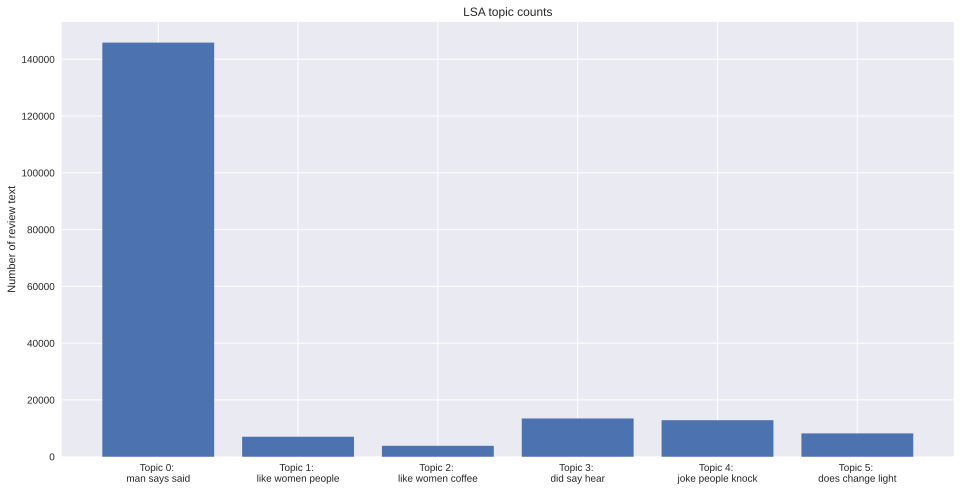

In [77]:
top_3_words = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)
labels = ['Topic {}: \n'.format(i) + top_3_words[i] for i in lsa_categories]

fig, ax = plt.subplots(figsize=(16,8))
ax.bar(lsa_categories, lsa_counts);
ax.set_xticks(lsa_categories);
ax.set_xticklabels(labels);
ax.set_ylabel('Number of review text');
ax.set_title('LSA topic counts');
plt.show();

In [78]:
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()

import spacy
from pprint import pprint
import en_core_web_sm


In [79]:
tsne_lsa_model = TSNE(n_components=2, perplexity=50, learning_rate=100, 
                        n_iter=2000, verbose=1, random_state=0, angle=0.75)
tsne_lsa_vectors = tsne_lsa_model.fit_transform(lsa_topic_matrix)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 191319 samples in 0.277s...
[t-SNE] Computed neighbors for 191319 samples in 35.161s...
[t-SNE] Computed conditional probabilities for sample 1000 / 191319
[t-SNE] Computed conditional probabilities for sample 2000 / 191319
[t-SNE] Computed conditional probabilities for sample 3000 / 191319
[t-SNE] Computed conditional probabilities for sample 4000 / 191319
[t-SNE] Computed conditional probabilities for sample 5000 / 191319
[t-SNE] Computed conditional probabilities for sample 6000 / 191319
[t-SNE] Computed conditional probabilities for sample 7000 / 191319
[t-SNE] Computed conditional probabilities for sample 8000 / 191319
[t-SNE] Computed conditional probabilities for sample 9000 / 191319
[t-SNE] Computed conditional probabilities for sample 10000 / 191319
[t-SNE] Computed conditional probabilities for sample 11000 / 191319
[t-SNE] Computed conditional probabilities for sample 12000 / 191319
[t-SNE] Computed conditional proba

In [80]:
def get_mean_topic_vectors(keys, two_dim_vectors):
    '''
    returns a list of centroid vectors from each predicted topic category
    '''
    mean_topic_vectors = []
    for t in range(n_topics):
        reviews_in_that_topic = []
        for i in range(len(keys)):
            if keys[i] == t:
                reviews_in_that_topic.append(two_dim_vectors[i])    
        
        reviews_in_that_topic = np.vstack(reviews_in_that_topic)
        mean_review_in_that_topic = np.mean(reviews_in_that_topic, axis=0)
        mean_topic_vectors.append(mean_review_in_that_topic)
    return mean_topic_vectors

In [81]:
colormap = np.array([
    "#1f77b4", "#aec7e8", "#ff7f0e", "#ffbb78", "#2ca02c",
    "#98df8a", "#d62728", "#ff9896", "#9467bd", "#c5b0d5",
    "#8c564b", "#c49c94", "#e377c2", "#f7b6d2", "#7f7f7f",
    "#c7c7c7", "#bcbd22", "#dbdb8d", "#17becf", "#9edae5" ])
colormap = colormap[:n_topics]

In [82]:
top_3_words_lsa = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)
lsa_mean_topic_vectors = get_mean_topic_vectors(lsa_keys, tsne_lsa_vectors)

plot = figure(title="t-SNE Clustering of {} LSA Topics".format(n_topics), plot_width=700, plot_height=700)
plot.scatter(x=tsne_lsa_vectors[:,0], y=tsne_lsa_vectors[:,1], color=colormap[lsa_keys])

for t in range(n_topics):
    label = Label(x=lsa_mean_topic_vectors[t][0], y=lsa_mean_topic_vectors[t][1], 
                  text=top_3_words_lsa[t], text_color=colormap[t])
    plot.add_layout(label)
    
show(plot)

### **CountVectorizer**  

The CountVectorizer method of vectorizing tokens transposes all the words/tokens into features and then provides a count of occurrence of each word. The result is called a document term matrix, which you can see below.  

First, we create the vectorizer object. Max_df=0.9 will remove words that appear in more than 90% of the reviews. Min_df=25 will remove words that appear in less than 25 reviews. Next, we create the spare matrix as the result of fit_transform(). Finally, we create a list of all the words/features. The result is our document term matrix. Each row represents individual employee reviews and counts of how many times each word/feature occurs in each review.  

In [ ]:
!pip install pyLDAvis==3.2.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pyLDAvis.gensim

In [ ]:
import pickle
import pyLDAvis.sklearn
from collections import Counter
from textblob import TextBlob
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation, NMF
from wordcloud import WordCloud, ImageColorGenerator

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')

def preprocess_news(df):
    corpus=[]
    stem=PorterStemmer()
    lem=WordNetLemmatizer()
    for news in df['joke']:
        words=[w for w in word_tokenize(news)]
        
        words=[lem.lemmatize(w) for w in words if len(w)>2]
        
        corpus.append(words)
    return corpus

corpus=preprocess_news(new_df)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [ ]:
dic=gensim.corpora.Dictionary(corpus)
bow_corpus = [dic.doc2bow(doc) for doc in corpus]

In [ ]:
lda_model = gensim.models.LdaMulticore(bow_corpus, 
                                   num_topics = 4, 
                                   id2word = dic,                                    
                                   passes = 10,
                                   workers = 2)
lda_model.show_topics()

Выходные данные были обрезаны до нескольких последних строк (5000).
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning:

Calling np.sum(generator) is deprecated, and in the future will give a different res

[(0,
  '0.053*"What" + 0.049*"the" + 0.040*"you" + 0.021*"Why" + 0.017*"did" + 0.016*"call" + 0.012*"and" + 0.011*"Because" + 0.011*"n\'t" + 0.009*"doe"'),
 (1,
  '0.076*"the" + 0.048*"and" + 0.022*"The" + 0.017*"his" + 0.017*"you" + 0.014*"say" + 0.013*"man" + 0.010*"that" + 0.009*"him" + 0.008*"for"'),
 (2,
  '0.026*"..." + 0.022*"you" + 0.017*"wa" + 0.015*"n\'t" + 0.012*"that" + 0.011*"her" + 0.010*"she" + 0.009*"your" + 0.009*"for" + 0.009*"have"'),
 (3,
  '0.072*"the" + 0.029*"and" + 0.015*"The" + 0.012*"that" + 0.010*"they" + 0.010*"for" + 0.010*"are" + 0.009*"wa" + 0.007*"have" + 0.006*"all"')]

In [ ]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, bow_corpus, dic)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.073676  0.023385       1        1  51.174008
2      0.073040 -0.178351       2        1  19.076419
3      0.112530  0.138465       3        1  18.471035
0     -0.259247  0.016500       4        1  11.278538, topic_info=     Term           Freq          Total Category  logprob  loglift
14    the  424002.000000  424002.000000  Default  30.0000  30.0000
20   What   49559.000000   49559.000000  Default  29.0000  29.0000
15    you  130143.000000  130143.000000  Default  28.0000  28.0000
66    The   98856.000000   98856.000000  Default  27.0000  27.0000
121   Why   18975.000000   18975.000000  Default  26.0000  26.0000
..    ...            ...            ...      ...      ...      ...
70    are    5097.196254   37774.676677   Topic4  -5.0684   0.1793
32    ...    5991.867454   69129.710656   Topic4  -4.9067  -0.2633
13    say    5211.388066   62238.891299   Topic4  -5.0462  -0.2979
9    have    4360.193578   42728.261176   Topic4  -5.2246  -0.1001
330  joke    2986.624294   14397.013439   Topic4  -5.6029   0.6094

[334 rows x 6 columns], token_table=       Topic      Freq    Term
term                          
32         1  0.327413     ...
32         2  0.515234     ...
32         3  0.070693     ...
32         4  0.086678     ...
3706       1  0.001757    Adam
...      ...       ...     ...
192        1  0.490590    your
192        2  0.397828    your
192        3  0.041613    your
192        4  0.069943    your
15063      4  0.998278  zombie

[542 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 4, 1])

# **Conclusion**  


Based on the results obtained, it seems that the data is very noisy, and all 5 types of jokes are very similar to each other. The zero class of jokes contains a lot of hashtags. The 4th grade contains the most unique words and the longest jokes. I think that the data should be cleaned, and it will also be extremely difficult to use already pre-trained embeddings.